Image-to-image translation is a class of vision and
graphics problems where the goal is to learn the mapping
between an input image and an output image using a training set of aligned image pairs.Our algorithm learns to automatically “translate” an image
from one into the other.In my application I will transfer style of  Vangogh  to landscape photos. Our goal is to learn a mapping G : X → Y.

Here is the installation of random Nature dataset and Van Gogh style dataset.

In [ ]:
!pip install opendatasets --upgrade --quiet
import opendatasets as od
dataset_url = 'https://www.kaggle.com/datasets/ipythonx/van-gogh-paintings'
od.download(dataset_url)
dataset_url = 'https://www.kaggle.com/datasets/arnaud58/landscape-pictures'
od.download(dataset_url)
dataset_url = 'https://www.kaggle.com/datasets/pointblanc/colors-of-van-gogh'
od.download(dataset_url)
#71c5ab7116e96ec07dfd501cb3ce0f78
#yunusemredarici77 DataMining  Project

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: yunusemredarici77
Your Kaggle Key: ··········


100%|██████████| 485M/485M [00:21<00:00, 23.9MB/s]



Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: yunusemredarici77
Your Kaggle Key: ··········


100%|██████████| 620M/620M [00:23<00:00, 28.1MB/s]



Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: yunusemredarici77
Your Kaggle Key: ··········


100%|██████████| 1.35G/1.35G [00:58<00:00, 24.6MB/s]


I found two diffirent dataset of Vangogh in Kaggle. Here is the reorganazing dataset by setting up by checking the length of them and testing ImageFolder class. I have 3956 pictures from van gogh's pictures and 4319 nature pictures.

In [ ]:
data_dir = 'van-gogh-paintings/VincentVanGogh'
data_dir2 = 'colors-of-van-gogh/vincent-van-gogh/vincent-van-gogh'
target ='van-gogh-paintings/VincentVanGogh'
import shutil

import os
from torchvision.datasets import ImageFolder
#os.removedirs('van-gogh-paintings/VincentVanGogh/.ipynb_checkpoints')
for cls in os.listdir(data_dir):
    print(cls, ':', len(os.listdir(data_dir + "/" + cls)))
"""
for folder in os.listdir(data_dir2):
  shutil.move(data_dir2+"/"+folder, target+"/"+folder)
"""
from torchvision.datasets import ImageFolder
dataset = ImageFolder(data_dir)
print(len(dataset))

"""
name_list=os.listdir("landscape/landscape-pictures")

for i in name_list[0:2294]:
  print(i)
  os.remove("landscape/landscape-pictures/"+i)
"""
data_dir1 = 'landscape'
dataset1 = ImageFolder(data_dir1)
len(dataset1)

1886 : 161
1885 : 328
unknown-year : 1
1862 : 3
Nuenen : 86
1876 : 5
1879 : 4
1878 : 1
1874 : 1
1877 : 2
1873 : 4
1882 : 191
Arles : 189
Drawings : 1002
1887 : 178
1875 : 1
Villege : 35
1881 : 78
Sketchesinletters : 129
WorksoftheyoungGogh : 31
1890 : 238
1889 : 208
1867 : 1
1883 : 126
1888 : 292
1880 : 3
Face : 28
Watercolors : 150
SaintRemy : 143
AuversOise : 79
1864 : 1
1884 : 104
Paris : 153
3956


4319

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Importing necessary libraries and setting random seed.

Set random seed for reproducibility ,What is a Random Seed?
A random seed is used to ensure that results are reproducible.
In other words, using this parameter makes sure that anyone who re-runs your code
will get the exact same outputs. Reproducibility is an
extremely important concept in data science and other fields.




In [ ]:
import os
import torch
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
from torchvision.utils import make_grid
import matplotlib.pyplot as plt
import torchvision.transforms as tt
import argparse
import os
import random
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.animation as animation
from IPython.display import HTML
import torch.nn as nn
import torch.nn.functional as F

"""Set random seed for reproducibility ,What is a Random Seed?
A random seed is used to ensure that results are reproducible.
In other words, using this parameter makes sure that anyone who re-runs your code
will get the exact same outputs. Reproducibility is an
extremely important concept in data science and other fields. """
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)


Random Seed:  999


Set directories for landscape type and vangong style

In [ ]:
torch.cuda.memory_summary(device=None, abbreviated=False)
# DIrectories
DIRECTORY = "van-gogh-paintings/VincentVanGogh"
DIRECTORY2 = "landscape"


Setting necessary functions for saving Model and loading them.

In [ ]:
def saveCheckpoint(Generative_XtoY_Model, Generative_YtoX_Model, Discriminative_X_Model, Discriminative_Y_Model):

    #Save Generative and Discriminative models parameters
    directory = 'save'
    os.makedirs(directory, exist_ok=True)
    #create path
    Generative_XtoY_path = os.path.join(directory+"/", 'Generative_XtoY_Model.pkl')
    Generative_YtoX_path = os.path.join(directory+"/", 'Generative_YtoX_Model.pkl')
    Discriminative_X_path = os.path.join(directory+"/", 'Discriminative_X_Model.pkl')
    Discriminative_Y_path = os.path.join(directory+"/", 'Discriminative_Y_Model.pkl')
    #save datas
    torch.save(Generative_XtoY_Model.state_dict(), Generative_XtoY_path)
    torch.save(Generative_YtoX_Model.state_dict(), Generative_YtoX_path)
    torch.save(Discriminative_X_Model.state_dict(), Discriminative_X_path)
    torch.save(Discriminative_Y_Model.state_dict(), Discriminative_Y_path)

def loadCheckpoint(directory):

    LoadedModel = torch.load(directory, map_location=None)
    print(' [*] Model loaded from directory %s successfully!' % directory)
    return LoadedModel



Normalize funtion which is necessary to show image grid.

In [ ]:
def reNormalize(BatchOfImage, meanValue=0.5, stdValue=0.5):
    if torch.is_tensor(BatchOfImage):
        BatchOfImage = BatchOfImage.detach().numpy()
    value=255
    reNormalized_image = (BatchOfImage * stdValue * value) + (meanValue * value)
    return np.uint8(reNormalized_image)

Necessary Functions for loading models and batch of pictures to cuda device in order to run them on GPU.

In [ ]:
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import numpy as np


def cuda_default():
  if torch.cuda.is_available():
    return torch.device('cuda')
  else:
    return torch.device('cpu')
def to_device(ModelData, device):
  if isinstance(ModelData, (list,tuple)):
    return [to_device(i, device) for i in ModelData]
  return ModelData.to(device, non_blocking=True)
class DeviceDataLoader():
  def __init__(self, dataloader, CDevice):
    self.dataloader = dataloader
    self.CDevice = CDevice
  def __iter__(self):
    for b in self.dataloader:
      yield to_device(b, self.CDevice)
  def __len__(self):
    return len(self.dataloader)

initial = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)
def d_normalization(tensorOfimage):
  return tensorOfimage * initial[1][0] + initial[0][0]
def show_images(Img, numMax=64):
  figure, xsubplott = plt.subplots(figsize=(10, 10))
  xsubplott.set_xticks([]); xsubplott.set_yticks([])
  xsubplott.imshow(make_grid(d_normalization(Img.detach()[:numMax]), nrow=8).permute(1, 2, 0))

Show function to show generated batch of images by our Generative Model.

In [ ]:
from torchvision.utils import save_image
sample_dir = 'generated'
os.makedirs(sample_dir, exist_ok=True)

def show_test(index ,BatchOfY, BatchOfX, Generative_YtoX_Model, Generative_XtoY_Model, meanValue=0.5, stdValue=0.5):
    """
    Shows results of generates based on test image input.
    """
    #Identify correct device
    #device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    device=cuda_default()
    #Create fake pictures for both cycles
    XFake = Generative_YtoX_Model(BatchOfY.to(device))
    YFake = Generative_XtoY_Model(BatchOfX.to(device))
    fake_fname = 'generated-images-{0:0=4d}.png'.format(index)
    #save_image(denorm(fake_images), os.path.join(sample_dir, fake_fname), nrow=8)
    save_image(d_normalization(YFake.cpu().detach()), os.path.join(sample_dir, fake_fname))
    #Generate grids
    Xgrid =  make_grid(BatchOfX, nrow=4).permute(1, 2, 0).detach().cpu().numpy()
    Ygrid =  make_grid(BatchOfY, nrow=4).permute(1, 2, 0).detach().cpu().numpy()
    FakeXgrid =  make_grid(XFake, nrow=4).permute(1, 2, 0).detach().cpu().numpy()
    FakeYgrid =  make_grid(YFake, nrow=4).permute(1, 2, 0).detach().cpu().numpy()
    #Normalize pictures to pixel range rom 0 to 255
    """
    X, XFake = reNormalize(Xgrid, meanValue, stdValue), reNormalize(FakeXgrid, meanValue, stdValue)
    Y, YFake = reNormalize(Ygrid, meanValue, stdValue), reNormalize(FakeYgrid, meanValue, stdValue)
    """
    X, XFake = d_normalization(Xgrid), d_normalization(FakeXgrid)
    Y, YFake = d_normalization(Ygrid), d_normalization(FakeYgrid)
    #Transformation from X -> Y
    fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, sharey=True,squeeze=True, width_ratios=None, height_ratios=None, figsize=(20, 10))
    ax1.imshow(X)
    ax1.axis('off')
    ax1.set_title('ORIGINAL_PICTURE')
    ax2.imshow(YFake)
    ax2.axis('off')
    ax2.set_title('Fake Y  (Vangogh)')
    plt.show()



Test ImageFolder class and show some images.

3956
4319


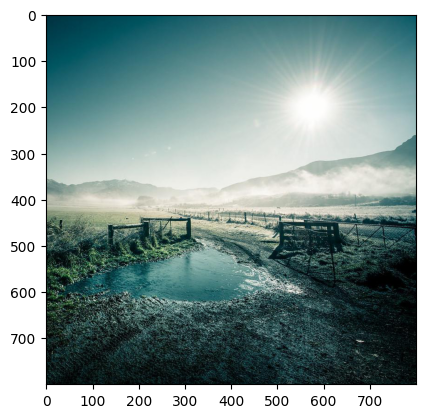

In [ ]:
Dataset = ImageFolder(DIRECTORY)
print(len(Dataset))
Dataset2 = ImageFolder(DIRECTORY2)
print(len(Dataset2))

img, label = Dataset[0]
plt.imshow(img)
img, label = Dataset[500]
plt.imshow(img)
img, label = Dataset2[21]
plt.imshow(img)

ImageFolder is Responsible for loading images from  folders into a PyTorch dataset also enable modify pictures as i did Resize,Crop and Normilize.

In [ ]:
import torchvision.transforms as tt
from torch.utils.data import DataLoader
from torchvision.utils import make_grid
SizeOfImage = 256
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)
#Create datasets
VangoghStyleDataset = ImageFolder(DIRECTORY, transform=tt.Compose([
  tt.Resize(SizeOfImage),
  tt.CenterCrop(SizeOfImage),
  tt.ToTensor(),
  tt.Normalize(*stats)]))
dataset_photo = ImageFolder(DIRECTORY2, transform=tt.Compose([
  tt.Resize(SizeOfImage),
  tt.CenterCrop(SizeOfImage),
  tt.ToTensor(),
  tt.Normalize(*stats)]))


PyTorch provides DataLoader wraps an iterable around the Dataset to enable easy access to the samples.

In [ ]:
DataloaderYForTest = DataLoader(VangoghStyleDataset, batch_size=8, shuffle=False, num_workers=0, pin_memory=True)
DataloaderXForTest = DataLoader(dataset_photo, batch_size=8, shuffle=False, num_workers=0, pin_memory=True)
dataloaderY = DataLoader(VangoghStyleDataset, batch_size=16, shuffle=True, num_workers=0, pin_memory=True)
dataloaderX = DataLoader(dataset_photo, batch_size=16, shuffle=True, num_workers=0, pin_memory=True)

In [ ]:
"""
def denorm(img_tensors):
  return img_tensors * stats[1][0] + stats[0][0]
def show_images(images, nmax=4):
  images=images.cpu()
  fig, ax = plt.subplots(figsize=(2, 4))
  ax.set_xticks([]); ax.set_yticks([])
  #ax.imshow(make_grid(denorm(images.detach()[:nmax]), nrow=8).permute(1, 2, 0))
  ax.imshow(make_grid(denorm(images.detach()), nrow=2).permute(1, 2, 0))
def show_batch(dl, nmax=4):
  for images, _ in dl:
    show_images(images, nmax)
    break
#show_batch(train_dl)
"""

Test DataLoader image batches of Vangogh Images

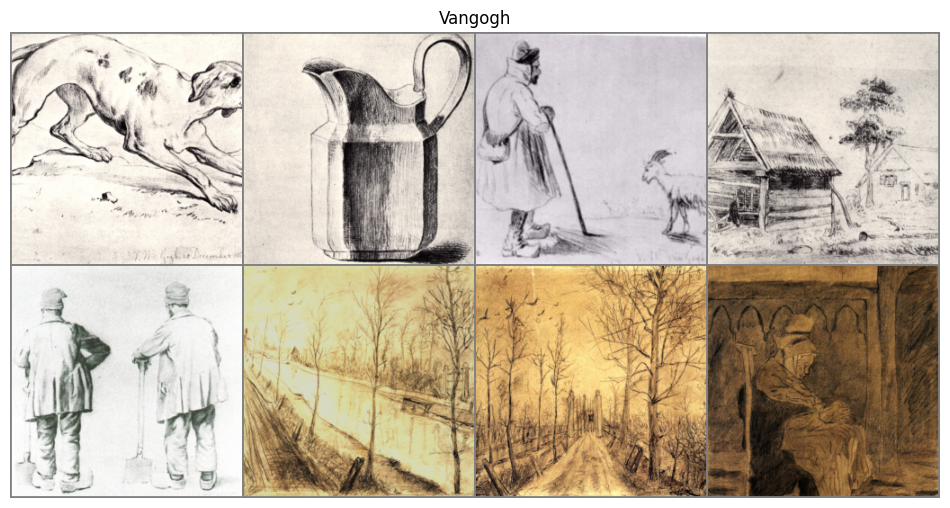

In [ ]:
#Check dataset & dataloader results
iterDataY = iter(DataloaderYForTest)
NextImgBatchY , clas = next(iterDataY)
gridImage = make_grid(NextImgBatchY, nrow=4).permute(1, 2, 0).detach().numpy()
gridY = d_normalization(gridImage)
fig = plt.figure(figsize=(12, 8))
plt.imshow(gridY)
plt.axis('off')
plt.title('Vangogh')
plt.show()



Test DataLoader image batches of Nture Images

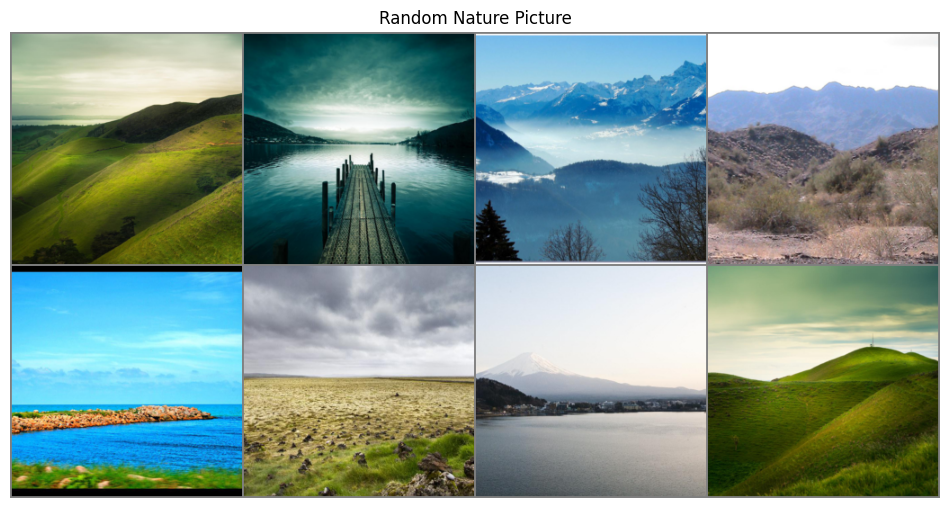

In [ ]:
#Check dataset & dataloader results
iterDataX = iter(DataloaderXForTest)
NextImgBatchX , clas = next(iterDataX)
gridImage = make_grid(NextImgBatchX, nrow=4).permute(1, 2, 0).detach().numpy()
gridX = d_normalization(gridImage)
fig = plt.figure(figsize=(12, 8))
plt.imshow(gridX)
plt.axis('off')
plt.title('Random Nature Picture')
plt.show()

Fills the input Tensor with values according to the method described .





In [ ]:
from torch.nn import init
def init_weights(m):
    if isinstance(m, nn.Linear):
        torch.nn.init.xavier_uniform(m.weight)
        m.bias.data.fill_(0.01)

To begin, I establish a helper function that generates a convolutional layer, allowing for optional batch or instance normalization. Initially, batch normalization was thought to enhance deep learning models by reducing the "internal covariate shift". Instance normalization is a similar technique that proves particularly effective for style transfer, hence my decision to implement it in the implementation.

In [ ]:
import torch.nn as nn
import torchvision.transforms as tt

import argparse
import random
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.animation as animation
from IPython.display import HTML
import torch.nn as nn
import torch.nn.functional as F

def single_conv(INPUTChannel, OUTPUTChannel, kernelSize, stride_=2, pad_=1, batchNormalization=False, instanceNormalization=False):

    all_layers = []
    convolution_layer = nn.Conv2d(in_channels=INPUTChannel, out_channels=OUTPUTChannel, kernel_size=kernelSize, stride=stride_, padding=pad_, dilation=1, groups=1, bias=False, padding_mode='zeros', device=None, dtype=None)

    all_layers.append(convolution_layer)

    if batchNormalization:
        all_layers.append(nn.BatchNorm2d(OUTPUTChannel))

    if instanceNormalization:
        all_layers.append(nn.InstanceNorm2d(OUTPUTChannel))
    return nn.Sequential(*all_layers)

Our model includes two CNNs, referred to as discriminators 𝐷iscriminator𝑋 and 𝐷iscriminator𝑌, which analyze images and attempt to classify them as real or fake. A classification close to 1 indicates a real image, while a classification close to 0 suggests a fake image. 𝐷iscriminator𝑌 focuses on encouraging and classifying the transformation from domain X to Y, converting photos into monet pictures. Conversely, 𝐷iscriminator𝑋 handles the classification of transformations from domain Y to X.
Input is RGB image (256x256x3) while output is a single value.


In [ ]:
class DiscriminativeModel(nn.Module):
    def __init__(self, convolution_dimention=64):
        super(DiscriminativeModel, self).__init__()
        #convolutionalLayers
        self.convolution1 = single_conv(INPUTChannel=3, OUTPUTChannel=convolution_dimention, kernelSize=4) # dimention of  [128 x 128 x 64]
        self.convolution2 = single_conv(INPUTChannel=convolution_dimention, OUTPUTChannel=convolution_dimention*2, kernelSize=4, stride_=2, pad_=1, batchNormalization=False, instanceNormalization=True)#dimention of  [64 x 64 x 128]
        self.convolution3 = single_conv(INPUTChannel=convolution_dimention*2, OUTPUTChannel=convolution_dimention*4, kernelSize=4,stride_=2, pad_=1, batchNormalization=False, instanceNormalization=True)# dimention of  [32 x 32 x 256]
        self.convolution4 = single_conv(INPUTChannel=convolution_dimention*4, OUTPUTChannel=convolution_dimention*8, kernelSize=4,stride_=2, pad_=1, batchNormalization=False, instanceNormalization=True)# dimention of  [16 x 16 x 512]
        self.convolution5 = single_conv(INPUTChannel=convolution_dimention*8, OUTPUTChannel=convolution_dimention*8, kernelSize=4,stride_=2, pad_=1, batchNormalization=True, instanceNormalization=False)# dimention of  [8 x 8 x 512]
        self.convolution6 = single_conv(convolution_dimention*8, OUTPUTChannel=1, kernelSize=4, stride_=1 )# dimention of  [8 x 8 x 1]
    def forward(self, a):
        #leaky_relu activation function is applied to layers
        output = F.leaky_relu(self.convolution1(a), negative_slope=0.2)
        output = F.leaky_relu(self.convolution2(output), negative_slope=0.2)
        output = F.leaky_relu(self.convolution3(output), negative_slope=0.2)
        output = F.leaky_relu(self.convolution4(output), negative_slope=0.2)
        output = self.convolution6(output)
        return output


 Residual blocks is necessary for the generative model to have influence of previous layer and learn strongly the tranformation from one layer to other layers. For my project I used 6 residual blocks in CycleGenerative Model structure.

In [ ]:
class ResidualBlock(nn.Module):

    def __init__(self, convolutional_dimention):
        super(ResidualBlock, self).__init__()
        self.convolution1 = single_conv(INPUTChannel=convolutional_dimention, OUTPUTChannel=convolutional_dimention, kernelSize=3, stride_=1, pad_=1,batchNormalization=False, instanceNormalization=True)
        self.convolution2 = single_conv(INPUTChannel=convolutional_dimention, OUTPUTChannel=convolutional_dimention, kernelSize=3, stride_=1, pad_=1, batchNormalization=False, instanceNormalization=True)

    def forward(self, a):
        output1 = F.relu(self.convolution1(a))
        outPUT2 = a + self.convolution2(output1)
        return outPUT2

Create Single De_Convolution layer In order to use it later in CycleGenerative Model.

In [ ]:
def deconvolution(INPUTChannel, OUTPUTChannel, kernelSize, stride_=2, pad_=1, batchNormalization=False, instanceNormalization=False, dropout_=False, dropoutRatio=0.5):
    """
    Create Single De_Convolution layer that enable us to choose either Batch_Normalization or Instance_Normalization
     """

    #Add layers
    layers = []
    layers.append(nn.ConvTranspose2d(in_channels=INPUTChannel, out_channels=OUTPUTChannel, kernel_size=kernelSize, stride=stride_, padding=pad_, output_padding=0, groups=1, bias=True, dilation=1, padding_mode='zeros'))

    #Apply Batch Normalization
    if batchNormalization:
        layers.append(nn.BatchNorm2d(OUTPUTChannel))

    #Apply Instance Normalization
    if instanceNormalization:
        layers.append(nn.InstanceNorm2d(OUTPUTChannel))
    #Apply Dropout
    if dropout_:
        layers.append(nn.Dropout2d(dropoutRatio))

    return nn.Sequential(*layers)

In our model, we utilize two generators: Generative_XtoY_Model and Generative_YtoX_Model. Each generator is composed of an encoder, which compresses the image into a smaller feature representation, residual blocks that connect the output of one layer with the input of an earlier layer, and a decoder that transforms the compressed representation into an image.

 In My implementation, I incorporate only one residual block. However, the generator includes a parameter that enables the repetition of this component multiple times, providing flexibility in its design.

 The advantage of using Leaky ReLU instead of ReLU is that in this way we cannot have vanishing gradient.

In [ ]:
class CycleGenerativeModel(nn.Module):
    def __init__(self, convolutionn_dimention=64, NumberOfResidualBlock=6):
        super(CycleGenerativeModel, self).__init__()

        #InputDimention -->[256,256,256] , output dimention -->[256,256,256]

        #EncoderLaayers
        self.convolution1 = single_conv(INPUTChannel=3, OUTPUTChannel=convolutionn_dimention, kernelSize=4)# dimention of  [128 x 128 x 64]
        self.convolution2 = single_conv(INPUTChannel=convolutionn_dimention, OUTPUTChannel=convolutionn_dimention*2, kernelSize=4, instanceNormalization=True)# dimention of  [64 x 64 x 128]
        self.convolution3 = single_conv(INPUTChannel=convolutionn_dimention*2, OUTPUTChannel=convolutionn_dimention*4, kernelSize=4, instanceNormalization=True)# dimention of  [32 x 32 x 256]
        #Residual_Blocks (number depends on input parameter)
        residual_layers = []
        for layer in range(NumberOfResidualBlock):
            residual_layers.append(ResidualBlock(convolutionn_dimention*4))
        self.residual_blocks = nn.Sequential(*residual_layers)

        #DecoderLayers
        self.convolution4 = deconvolution(INPUTChannel=convolutionn_dimention*4, OUTPUTChannel=convolutionn_dimention*2, kernelSize=4, stride_=2, pad_=1, batchNormalization=False, instanceNormalization=True, dropout_=False, dropoutRatio=0.5)# dimention of  [64 x 64 x 128]
        self.convolution5 = deconvolution(INPUTChannel=convolutionn_dimention*2, OUTPUTChannel=convolutionn_dimention, kernelSize=4, stride_=2, pad_=1, batchNormalization=False, instanceNormalization=True, dropout_=False, dropoutRatio=0.5)# dimention of  [128 x 128 x 64]
        self.convolution6 = deconvolution(INPUTChannel=convolutionn_dimention, OUTPUTChannel=3, kernelSize=4, stride_=2, pad_=1, batchNormalization=False, instanceNormalization=True, dropout_=False, dropoutRatio=0.5)# dimention of  [256 x 256 x 3]
    def forward(self, a):

        #Input Image A is transformed to same dimention Image.


        #EncoderForward
        output = F.leaky_relu(self.convolution1(a), negative_slope=0.2)
        output = F.leaky_relu(self.convolution2(output), negative_slope=0.2)
        output = F.leaky_relu(self.convolution3(output), negative_slope=0.2)
        #Residual_Blocks_Forward
        output = self.residual_blocks(output)

        #DecoderFoward
        output = F.leaky_relu(self.convolution4(output), negative_slope=0.2)
        output = F.leaky_relu(self.convolution5(output), negative_slope=0.2)
        output = torch.tanh(self.convolution6(output)) #eventual output is (256, 256, 3)
        return output

Build our model and move models to GPU if available (otherwise stay on CPU) and initialize the weights.

In [ ]:
def build_model(GenerativeConvDim=64, DiscriminativeConvDim=64, NumberOfResidualBlock=6):

    #build_model for CycleGenerativeModelXtoY & CycleGenerativeModelYtoX and DiscriminativeModel_X & DiscriminativeModel_Y

    #Generative Models
    Generative_XtoY_Model = CycleGenerativeModel(convolutionn_dimention=GenerativeConvDim, NumberOfResidualBlock=NumberOfResidualBlock)
    Generative_YtoX_Model = CycleGenerativeModel(convolutionn_dimention=GenerativeConvDim, NumberOfResidualBlock=NumberOfResidualBlock)

    #Discriminative Models
    Discriminative_X_Model = DiscriminativeModel(convolution_dimention=DiscriminativeConvDim) # Y-->X
    Discriminative_Y_Model = DiscriminativeModel(convolution_dimention=DiscriminativeConvDim) # X-->Y

    #Initialize Weight
    Generative_XtoY_Model.apply(init_weights)
    Generative_YtoX_Model.apply(init_weights)
    Discriminative_X_Model.apply(init_weights)
    Discriminative_Y_Model.apply(init_weights)
    #IF there is Available GPU then MOVE models
    if torch.cuda.is_available():
       #device = torch.device('cuda')
        device=cuda_default()
        Generative_XtoY_Model.to(device)
        Generative_YtoX_Model.to(device)
        Discriminative_X_Model.to(device)
        Discriminative_Y_Model.to(device)
        print('Models will work on GPU. ')
    else:
        print('Model will work on CPU. Only CPU available.')

    return Generative_XtoY_Model, Generative_YtoX_Model, Discriminative_X_Model, Discriminative_Y_Model


In [ ]:
#Get Models Variables
Generative_XtoY_Model, Generative_YtoX_Model, Discriminative_X_Model, Discriminative_Y_Model = build_model()


Models will work on GPU. 


In [ ]:
#Print builded Models
def print_build(Generative_XtoY_Model, Generative_YtoX_Model, Discriminative_X_Model, Discriminative_Y_Model):
    print("                     Generative_XtoY_Model                    ")
    print("___________________________________________________")
    print(Generative_XtoY_Model)
    print("---------")

    print("                     Generative_YtoX_Model                    ")
    print("___________________________________________________")
    print(Generative_YtoX_Model)
    print("---------")

    print("                      Discriminative_X_Model                      ")
    print("___________________________________________________")
    print(Discriminative_X_Model)
    print("---------")

    print("                      Discriminative_Y_Model                      ")
    print("___________________________________________________")
    print(Discriminative_Y_Model)
    print("---------")

print_build(Generative_XtoY_Model, Generative_YtoX_Model, Discriminative_X_Model, Discriminative_Y_Model)


                     Generative_XtoY_Model                    
___________________________________________________
CycleGenerativeModel(
  (convolution1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  )
  (convolution2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
  )
  (convolution3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
  )
  (residual_blocks): Sequential(
    (0): ResidualBlock(
      (convolution1): Sequential(
        (0): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      )
      (convolutio

Loss Function
I have used 3 diffirent loss function as proposed on the paper(https://arxiv.org/pdf/1703.10593.pdf)
Those are Identity Loss, Cycle Loss and Loss MeanSquareError.

MeanSquareError
We utilize two discriminator losses. The loss for each function is computed as the mean squared error between the discriminator's output and the target value (either 1 or 0). In the code, this is implemented using Mean Square Error Real Loss and Mean Square Error Fake Loss.

Cycle  Loss
There are two aspects to cycle  loss. First, the forward cycle-consistency loss is calculated by transforming an input from X to Y and then back to X, and measuring the difference. Second, the backward cycle-consistency loss is computed by transforming an input from Y to X and then back to Y, and measuring the discrepancy.

Identity Loss:
The identity loss consists of two components. First, the forward identity loss is determined by transforming an input from X to Y and comparing it to the original Y. Second, the backward identity loss is determined by transforming an input from Y to X and comparing it to the original X.

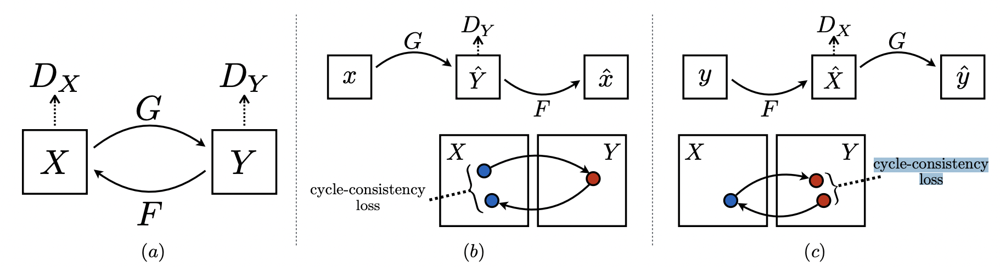

In [ ]:
def MeanSquareErrorRealLoss(DiscriminatorOut, adverserialWeight=1):
    LossMeanSquareError = torch.mean((DiscriminatorOut-1)**2)*adverserialWeight
    return LossMeanSquareError

def MeanSquareErrorFakeLoss(DiscriminatorOut, adverserialWeight=1):
    LossMeanSquareError = torch.mean(DiscriminatorOut**2)*adverserialWeight
    return LossMeanSquareError

def CycleConsistentyLoss(realImage, ImageReconstructed, lambdaWeight=1):
    LossReconstructed = torch.mean(torch.abs(realImage - ImageReconstructed))
    return lambdaWeight*LossReconstructed

def LossIdentity(realImage, ImageGenerated, IdentityWeight=1):
    LossIdentitity = torch.mean(torch.abs(realImage - ImageGenerated))
    return IdentityWeight*LossIdentitity

I assigned Adam optimizer to Generative and Discriminative models as optimizer model.
Adam is one of the most used optimizers for training deep learning models. It is fast and quite efficient when you have a lot of data for training. Adam is an optimizer with momentum that can perform better than SGD when the model is complex, as in most cases of deep learning.

In [ ]:
#OptimizerHyperprameters
import torch.optim as optimizer
lr=0.0002
generative_parameters = list(Generative_XtoY_Model.parameters()) + list(Generative_YtoX_Model.parameters())

generativeOpt = optimizer.Adam(generative_parameters, lr, [0.5, 0.999])
discriminatorXopt = optimizer.Adam(Discriminative_X_Model.parameters(), lr, [0.500, 0.999])
discriminatorYopt = optimizer.Adam(Discriminative_Y_Model.parameters(), lr, [0.500, 0.999])


#####FIRST PART TRAIN DISCRIMINATOR_X ON REAL AND FAKE IMAGES#####

1. To reset the gradients of all parameters tracked by the optimizer of the discriminative_X model, use the ZERO_GRAD() method.
2. Calculate the losses of the discriminator on real images.
3. Create synthetic images resembling domain X by using real images from domain Y as a reference.
4. Calculate the loss for the generated fake images in relation to discriminative_X.
5. Compute the overall loss and initiate backpropagation.

#####SECOND PART TRAIN DISCRIMINATOR_Y ON REAL AND FAKE IMAGES#####

1. To reset the gradients of all parameters tracked by the optimizer of the discriminative_Y model, use the ZERO_GRAD() method.
2. Calculate the losses of the discriminator on real images.
3. Create synthetic images resembling domain Y by using real images from domain X as a reference.
4. Calculate the loss for the generated fake images in relation to discriminative_Y.
5. Compute the overall loss and initiate backpropagation.


#####THIRD PART TRAIN GENERATIVE_Y_TO_X MODEL on Real and Reconstructed Images Plus Transformation Loss of Real image Y domain and fake X domain
1. To reset the gradients of the optimizer for the GENERATIVE_Y_TO_X model, utilize the ZERO_GRAD() method to clear them.
2. Generate synthetic images resembling domain X by using real images from domain Y as a basis.
3. Calculate the generator loss using domain X as a reference.
4. Generate a reconstructed version of domain Y.
5. Compute the cycle consistency loss, which measures the discrepancy between the original and reconstructed images.
6. Calculate the identity loss resulting from the transformation of Y to X.

#####FOURTH PART TRAIN GENERATIVE_X_TO_Y MODEL on Real and reconstructed images plus transformation loss on Real imageS of NATURE, fake imageS of VAN GOGH

1. Generate synthetic images resembling domain Y by using real images from domain X as a basis.
2. Calculate the generator loss using domain Y as a reference.
3.  Generate a reconstructed version of domain X.
4. Compute the cycle consistency loss, which measures the discrepancy between the original and reconstructed images.
5. Calculate the identity loss resulting from the transformation of X to Y.
6. Add up all generator and reconstructed losses and perform backprop
Calculate GenerativeTotalLoss = LossGenerativeYtoX + LossGenerativeXtoY + LossReconstructedY + LossReconstructedX + LossIdentityY + LossIdentityX,  then use it backpropagation of generativeOpt.

In [ ]:

def trainModel(dataloaderX, dataloaderY, DataloaderXForTest, DataloaderYForTest, NumOfEpoch=1000):

    #LossList over_Time
    lossList = []
    #Weights for computing the Error Impact on backpropagation    adverserialWeight = 0.5
    lambdaWeight = 10
    IdentityWeight = 5
    index=0

    # Iter Class that return list of batch of images
    XIter = iter(dataloaderX)
    YIter = iter(dataloaderY)
    batchesPerEpoch = min(len(XIter), len(YIter))
    #Average loss over batches per epoch runs
    DiscriminativeTotalLossAvg = 0.0
    GenerativeTotalLossAvg = 0.0
    #Loop through epochs
    for i in range(1, NumOfEpoch+1):

        #Restart iteration
        if i % batchesPerEpoch == 0:
            XIter = iter(dataloaderX)
            YIter = iter(dataloaderY)

        #GetImageBatchX from ITERATION LIST by next method
        NextImgBatchXX,clasx = next(XIter)

        #GetImageBatchY from ITERATION LIST by next method
        NextImgBatchYY,clasy = next(YIter)

        #IF  there is available GPU , move batchofimage to GPU , otherwise keep going with CPU
        device=cuda_default()
        #device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

        NextImgBatchXX = NextImgBatchXX.to(device)
        NextImgBatchYY = NextImgBatchXX.to(device)

        #............TRAINING DISCRIMINATORS PART ..........

        ##FIRST PART TRAIN DISCRIMINATOR_X ON REAL AND FAKE IMAGES##

        #zero_grad() method is used to clear out the gradients of all parameters that the optimizer is tracking.
        discriminatorXopt.zero_grad()

        outputX = Discriminative_X_Model(NextImgBatchXX)
        DiscriminativeXRealLoss = MeanSquareErrorRealLoss(outputX, adverserialWeight = 0.5)

        fakeImageBatchXX = Generative_YtoX_Model(NextImgBatchYY)

        outputX = Discriminative_X_Model(fakeImageBatchXX)
        DiscriminativeXFakeLoss = MeanSquareErrorFakeLoss(outputX, adverserialWeight = 0.5)

        LossXDiscriminative = DiscriminativeXRealLoss + DiscriminativeXFakeLoss
        LossXDiscriminative.backward()
        discriminatorXopt.step()

        ##SECOND PART TRAIN DISCRIMINATOR_Y ON REAL AND FAKE IMAGES##

        #zero_grad() method is used to clear out the gradients of all parameters that the optimizer is tracking.
        discriminatorYopt.zero_grad()


        outputY = Discriminative_Y_Model(NextImgBatchYY)
        DiscriminativeYRealLoss = MeanSquareErrorRealLoss(outputY, adverserialWeight = 0.5)

        fakeImageBatchYY = Generative_XtoY_Model(NextImgBatchXX)

        outputY = Discriminative_Y_Model(fakeImageBatchYY)
        DiscriminativeYFakeLoss = MeanSquareErrorFakeLoss(outputY, adverserialWeight = 0.5)

        DiscriminativeYLoss = DiscriminativeYRealLoss + DiscriminativeYFakeLoss
        DiscriminativeYLoss.backward()
        discriminatorYopt.step()

        DiscriminativeTotalLoss = LossXDiscriminative + DiscriminativeYLoss

        #.......   TRAIN GENERATIVE MODELS.....
        ##THIRD PART TRAIN GENERATIVE_Y_TO_X MODEL on Real and reconstructed images
        # plus transformation loss on Real imageS of Van Gogh, fake imageS of Nature ##

        #zero_grad() method is used to clear out the gradients of all parameters that the optimizer is tracking.
        generativeOpt.zero_grad()

        fakeImageBatchXX = Generative_YtoX_Model(NextImgBatchYY)

        outputX = Discriminative_X_Model(fakeImageBatchXX)
        LossGenerativeYtoX = MeanSquareErrorRealLoss(outputX, adverserialWeight)

        reconstructedY = Generative_XtoY_Model(fakeImageBatchXX)

        LossReconstructedY = CycleConsistentyLoss(NextImgBatchYY, reconstructedY, lambdaWeight=lambdaWeight)

        LossIdentityY = LossIdentity(NextImgBatchYY, fakeImageBatchXX, IdentityWeight=IdentityWeight)

        ##FOURTH PART TRAIN GENERATIVE_X_TO_Y MODEL on Real and reconstructed images
        # plus transformation loss on Real imageS of NATURE, fake imageS of VAN GOGH ##

        fakeImageBatchYY = Generative_XtoY_Model(NextImgBatchXX)

        outputY = Discriminative_Y_Model(fakeImageBatchYY) #if discriminator believes picture to be from domain Y it returns values cloer to 1, else closer to 0
        LossGenerativeXtoY = MeanSquareErrorRealLoss(outputY, adverserialWeight)

        reconstructedX = Generative_YtoX_Model(fakeImageBatchYY)

        LossReconstructedX = CycleConsistentyLoss(NextImgBatchXX, reconstructedX, lambdaWeight=lambdaWeight)

        LossIdentityX = LossIdentity(NextImgBatchXX, fakeImageBatchYY, IdentityWeight=IdentityWeight)

        GenerativeTotalLoss = LossGenerativeYtoX + LossGenerativeXtoY + LossReconstructedY + LossReconstructedX + LossIdentityY + LossIdentityX
        GenerativeTotalLoss.backward()
        generativeOpt.step()

        DiscriminativeTotalLossAvg = DiscriminativeTotalLossAvg + DiscriminativeTotalLoss / batchesPerEpoch
        GenerativeTotalLossAvg = GenerativeTotalLossAvg + GenerativeTotalLoss / batchesPerEpoch

        newbatch = batchesPerEpoch
        if i % newbatch == 0:
            lossList.append((DiscriminativeTotalLossAvg.item(), GenerativeTotalLossAvg.item()))
            NumberEpocsTrue = int(i/batchesPerEpoch)
            NumberEpocsTotal = int(NumOfEpoch/batchesPerEpoch)
            print('Epoch [{:4d}/{:4d}] || DiscriminativeTotalLossAvg: {:5.3f} || GenerativeTotalLossAvg: {:5.3f}'.format(
                    NumberEpocsTrue, NumberEpocsTotal, DiscriminativeTotalLossAvg.item(), GenerativeTotalLossAvg.item()))

        show_every = (batchesPerEpoch*10)
        if i % show_every == 0:

            index += 1
            Generative_YtoX_Model.eval()
            Generative_XtoY_Model.eval()
            show_test(index,NextImgBatchY, NextImgBatchX, Generative_YtoX_Model, Generative_XtoY_Model)
            Generative_YtoX_Model.train()
            Generative_XtoY_Model.train()

        if i % batchesPerEpoch == 0:
            DiscriminativeTotalLossAvg = 0.0
            GenerativeTotalLossAvg = 0.0

    saveCheckpoint(Generative_XtoY_Model, Generative_YtoX_Model, Discriminative_X_Model, Discriminative_Y_Model)
    return lossList




Epoch [   1/ 300] || DiscriminativeTotalLossAvg: 0.398 || GenerativeTotalLossAvg: 7.597
Epoch [   2/ 300] || DiscriminativeTotalLossAvg: 0.274 || GenerativeTotalLossAvg: 6.962
Epoch [   3/ 300] || DiscriminativeTotalLossAvg: 0.228 || GenerativeTotalLossAvg: 6.735
Epoch [   4/ 300] || DiscriminativeTotalLossAvg: 0.218 || GenerativeTotalLossAvg: 6.526
Epoch [   5/ 300] || DiscriminativeTotalLossAvg: 0.199 || GenerativeTotalLossAvg: 6.443
Epoch [   6/ 300] || DiscriminativeTotalLossAvg: 0.168 || GenerativeTotalLossAvg: 6.299
Epoch [   7/ 300] || DiscriminativeTotalLossAvg: 0.168 || GenerativeTotalLossAvg: 6.209
Epoch [   8/ 300] || DiscriminativeTotalLossAvg: 0.159 || GenerativeTotalLossAvg: 6.138
Epoch [   9/ 300] || DiscriminativeTotalLossAvg: 0.171 || GenerativeTotalLossAvg: 6.016
Epoch [  10/ 300] || DiscriminativeTotalLossAvg: 0.148 || GenerativeTotalLossAvg: 6.015


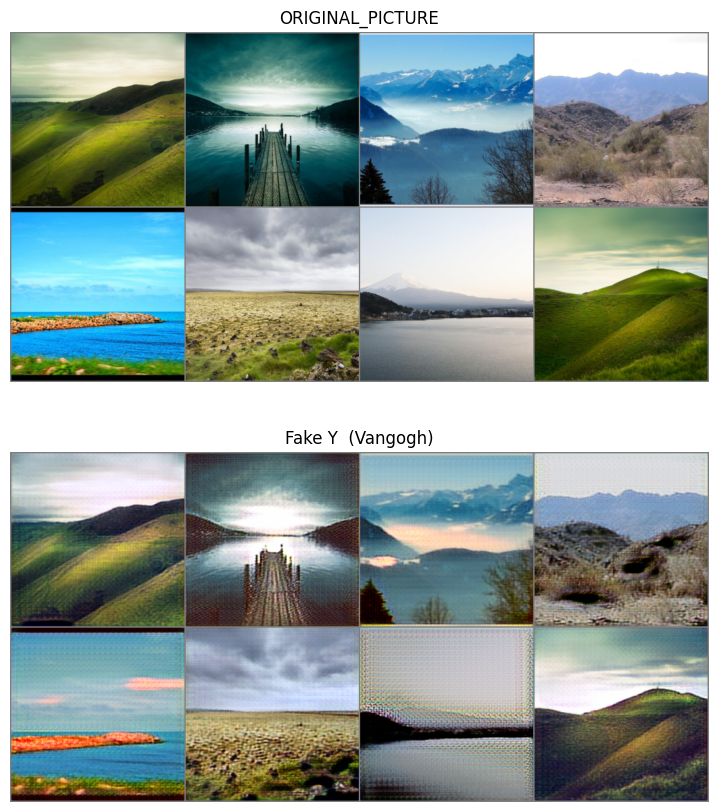

Epoch [  11/ 300] || DiscriminativeTotalLossAvg: 0.135 || GenerativeTotalLossAvg: 5.959
Epoch [  12/ 300] || DiscriminativeTotalLossAvg: 0.138 || GenerativeTotalLossAvg: 5.888
Epoch [  13/ 300] || DiscriminativeTotalLossAvg: 0.128 || GenerativeTotalLossAvg: 5.852
Epoch [  14/ 300] || DiscriminativeTotalLossAvg: 0.132 || GenerativeTotalLossAvg: 5.793
Epoch [  15/ 300] || DiscriminativeTotalLossAvg: 0.129 || GenerativeTotalLossAvg: 5.789
Epoch [  16/ 300] || DiscriminativeTotalLossAvg: 0.116 || GenerativeTotalLossAvg: 5.716
Epoch [  17/ 300] || DiscriminativeTotalLossAvg: 0.112 || GenerativeTotalLossAvg: 5.702
Epoch [  18/ 300] || DiscriminativeTotalLossAvg: 0.126 || GenerativeTotalLossAvg: 5.669
Epoch [  19/ 300] || DiscriminativeTotalLossAvg: 0.112 || GenerativeTotalLossAvg: 5.655
Epoch [  20/ 300] || DiscriminativeTotalLossAvg: 0.109 || GenerativeTotalLossAvg: 5.628


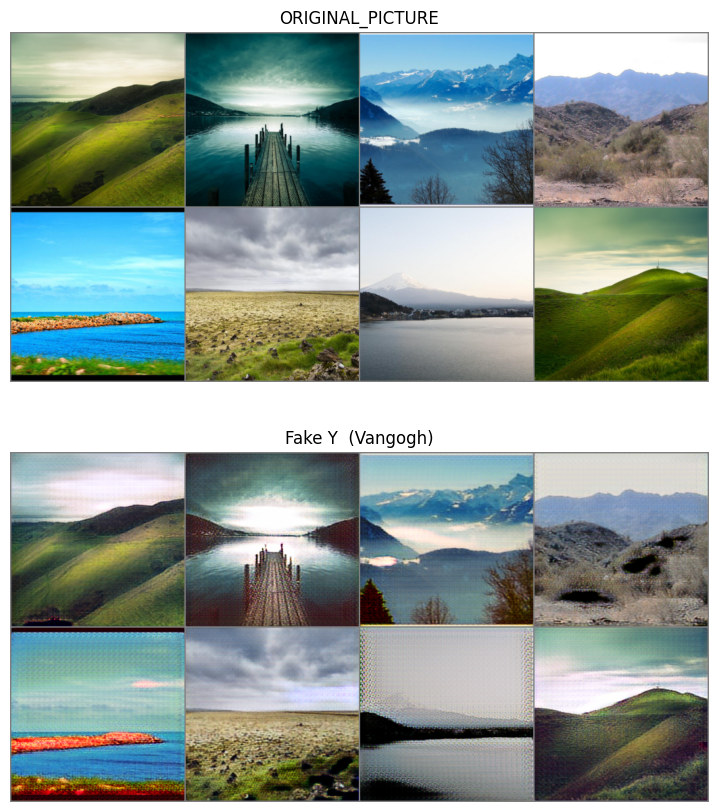

Epoch [  21/ 300] || DiscriminativeTotalLossAvg: 0.106 || GenerativeTotalLossAvg: 5.590
Epoch [  22/ 300] || DiscriminativeTotalLossAvg: 0.128 || GenerativeTotalLossAvg: 5.531
Epoch [  23/ 300] || DiscriminativeTotalLossAvg: 0.103 || GenerativeTotalLossAvg: 5.529
Epoch [  24/ 300] || DiscriminativeTotalLossAvg: 0.096 || GenerativeTotalLossAvg: 5.526
Epoch [  25/ 300] || DiscriminativeTotalLossAvg: 0.100 || GenerativeTotalLossAvg: 5.509
Epoch [  26/ 300] || DiscriminativeTotalLossAvg: 0.103 || GenerativeTotalLossAvg: 5.489
Epoch [  27/ 300] || DiscriminativeTotalLossAvg: 0.096 || GenerativeTotalLossAvg: 5.469
Epoch [  28/ 300] || DiscriminativeTotalLossAvg: 0.102 || GenerativeTotalLossAvg: 5.456
Epoch [  29/ 300] || DiscriminativeTotalLossAvg: 0.096 || GenerativeTotalLossAvg: 5.439
Epoch [  30/ 300] || DiscriminativeTotalLossAvg: 0.098 || GenerativeTotalLossAvg: 5.418


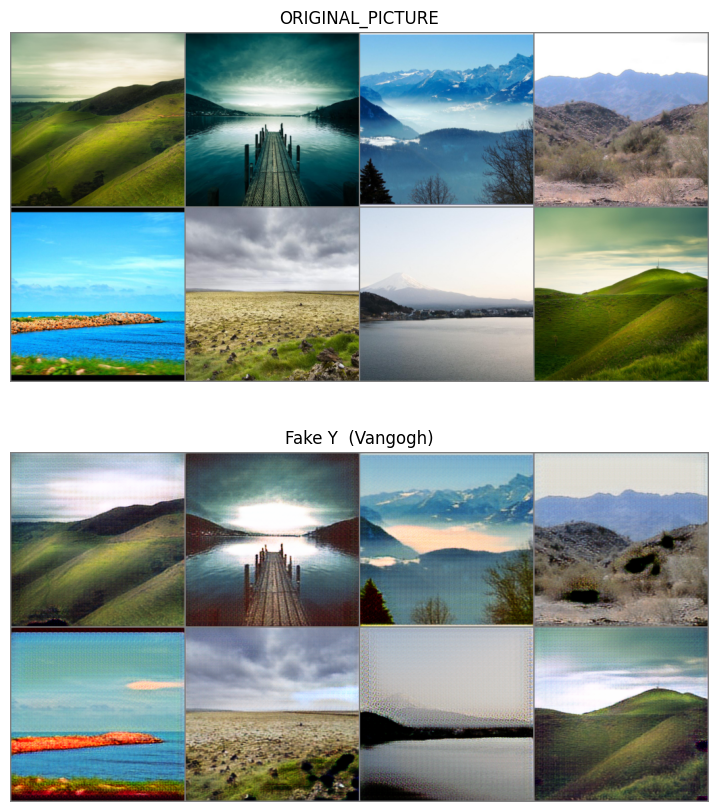

Epoch [  31/ 300] || DiscriminativeTotalLossAvg: 0.090 || GenerativeTotalLossAvg: 5.366
Epoch [  32/ 300] || DiscriminativeTotalLossAvg: 0.093 || GenerativeTotalLossAvg: 5.434
Epoch [  33/ 300] || DiscriminativeTotalLossAvg: 0.093 || GenerativeTotalLossAvg: 5.368
Epoch [  34/ 300] || DiscriminativeTotalLossAvg: 0.096 || GenerativeTotalLossAvg: 5.335
Epoch [  35/ 300] || DiscriminativeTotalLossAvg: 0.090 || GenerativeTotalLossAvg: 5.362
Epoch [  36/ 300] || DiscriminativeTotalLossAvg: 0.089 || GenerativeTotalLossAvg: 5.328
Epoch [  37/ 300] || DiscriminativeTotalLossAvg: 0.089 || GenerativeTotalLossAvg: 5.322
Epoch [  38/ 300] || DiscriminativeTotalLossAvg: 0.084 || GenerativeTotalLossAvg: 5.326
Epoch [  39/ 300] || DiscriminativeTotalLossAvg: 0.082 || GenerativeTotalLossAvg: 5.305
Epoch [  40/ 300] || DiscriminativeTotalLossAvg: 0.088 || GenerativeTotalLossAvg: 5.285


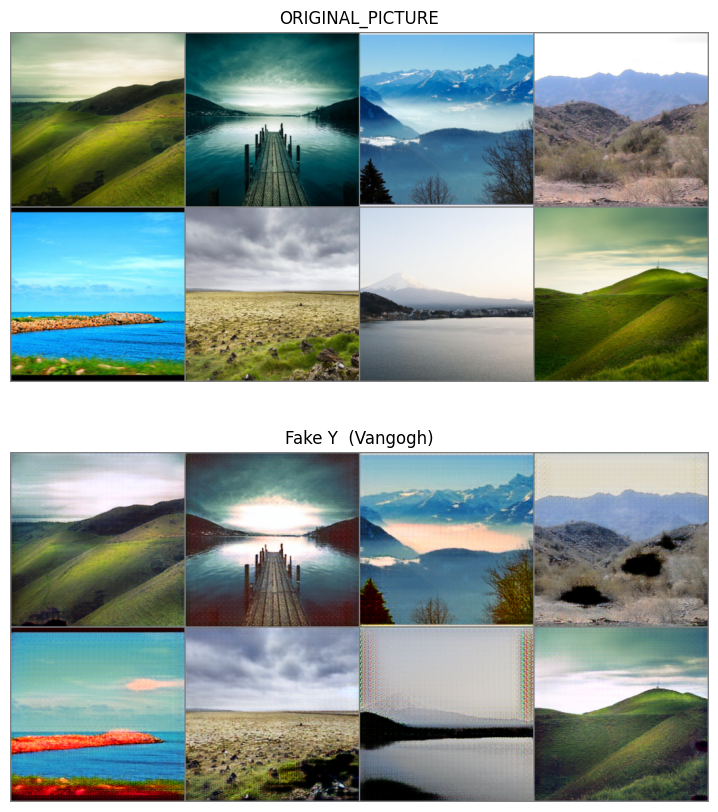

Epoch [  41/ 300] || DiscriminativeTotalLossAvg: 0.080 || GenerativeTotalLossAvg: 5.278
Epoch [  42/ 300] || DiscriminativeTotalLossAvg: 0.125 || GenerativeTotalLossAvg: 5.246
Epoch [  43/ 300] || DiscriminativeTotalLossAvg: 0.084 || GenerativeTotalLossAvg: 5.238
Epoch [  44/ 300] || DiscriminativeTotalLossAvg: 0.077 || GenerativeTotalLossAvg: 5.219
Epoch [  45/ 300] || DiscriminativeTotalLossAvg: 0.077 || GenerativeTotalLossAvg: 5.245
Epoch [  46/ 300] || DiscriminativeTotalLossAvg: 0.077 || GenerativeTotalLossAvg: 5.206
Epoch [  47/ 300] || DiscriminativeTotalLossAvg: 0.079 || GenerativeTotalLossAvg: 5.229
Epoch [  48/ 300] || DiscriminativeTotalLossAvg: 0.079 || GenerativeTotalLossAvg: 5.224
Epoch [  49/ 300] || DiscriminativeTotalLossAvg: 0.073 || GenerativeTotalLossAvg: 5.176
Epoch [  50/ 300] || DiscriminativeTotalLossAvg: 0.073 || GenerativeTotalLossAvg: 5.193


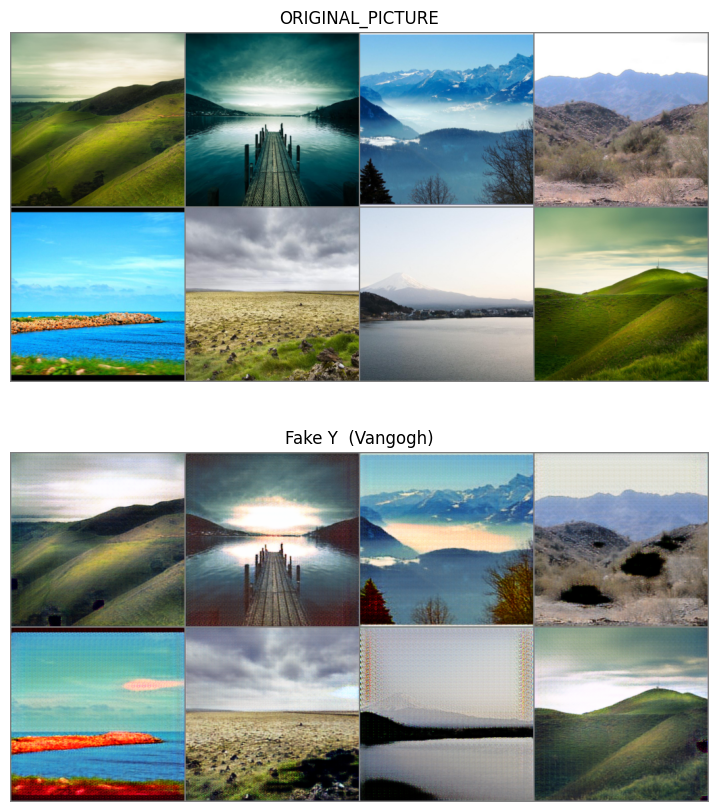

Epoch [  51/ 300] || DiscriminativeTotalLossAvg: 0.080 || GenerativeTotalLossAvg: 5.189
Epoch [  52/ 300] || DiscriminativeTotalLossAvg: 0.079 || GenerativeTotalLossAvg: 5.157
Epoch [  53/ 300] || DiscriminativeTotalLossAvg: 0.077 || GenerativeTotalLossAvg: 5.151
Epoch [  54/ 300] || DiscriminativeTotalLossAvg: 0.076 || GenerativeTotalLossAvg: 5.136
Epoch [  55/ 300] || DiscriminativeTotalLossAvg: 0.073 || GenerativeTotalLossAvg: 5.126
Epoch [  56/ 300] || DiscriminativeTotalLossAvg: 0.072 || GenerativeTotalLossAvg: 5.137
Epoch [  57/ 300] || DiscriminativeTotalLossAvg: 0.088 || GenerativeTotalLossAvg: 5.127
Epoch [  58/ 300] || DiscriminativeTotalLossAvg: 0.070 || GenerativeTotalLossAvg: 5.136
Epoch [  59/ 300] || DiscriminativeTotalLossAvg: 0.072 || GenerativeTotalLossAvg: 5.091
Epoch [  60/ 300] || DiscriminativeTotalLossAvg: 0.071 || GenerativeTotalLossAvg: 5.106


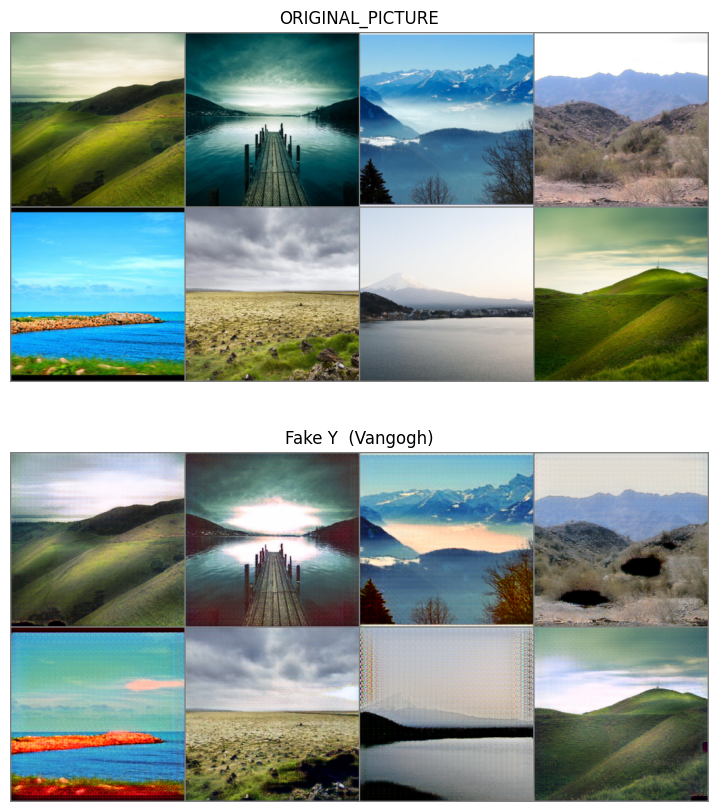

Epoch [  61/ 300] || DiscriminativeTotalLossAvg: 0.061 || GenerativeTotalLossAvg: 5.118
Epoch [  62/ 300] || DiscriminativeTotalLossAvg: 0.074 || GenerativeTotalLossAvg: 5.093
Epoch [  63/ 300] || DiscriminativeTotalLossAvg: 0.066 || GenerativeTotalLossAvg: 5.093
Epoch [  64/ 300] || DiscriminativeTotalLossAvg: 0.074 || GenerativeTotalLossAvg: 5.066
Epoch [  65/ 300] || DiscriminativeTotalLossAvg: 0.070 || GenerativeTotalLossAvg: 5.043
Epoch [  66/ 300] || DiscriminativeTotalLossAvg: 0.066 || GenerativeTotalLossAvg: 5.061
Epoch [  67/ 300] || DiscriminativeTotalLossAvg: 0.067 || GenerativeTotalLossAvg: 5.043
Epoch [  68/ 300] || DiscriminativeTotalLossAvg: 0.067 || GenerativeTotalLossAvg: 5.062
Epoch [  69/ 300] || DiscriminativeTotalLossAvg: 0.064 || GenerativeTotalLossAvg: 5.035
Epoch [  70/ 300] || DiscriminativeTotalLossAvg: 0.065 || GenerativeTotalLossAvg: 5.040


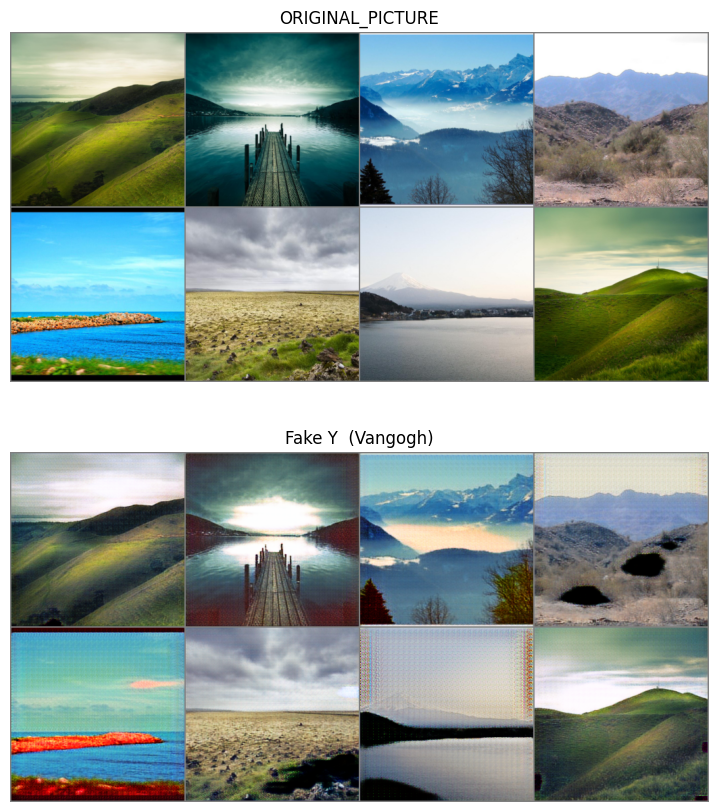

Epoch [  71/ 300] || DiscriminativeTotalLossAvg: 0.068 || GenerativeTotalLossAvg: 5.034
Epoch [  72/ 300] || DiscriminativeTotalLossAvg: 0.062 || GenerativeTotalLossAvg: 5.038
Epoch [  73/ 300] || DiscriminativeTotalLossAvg: 0.061 || GenerativeTotalLossAvg: 5.056
Epoch [  74/ 300] || DiscriminativeTotalLossAvg: 0.062 || GenerativeTotalLossAvg: 5.040
Epoch [  75/ 300] || DiscriminativeTotalLossAvg: 0.066 || GenerativeTotalLossAvg: 5.019
Epoch [  76/ 300] || DiscriminativeTotalLossAvg: 0.063 || GenerativeTotalLossAvg: 5.006
Epoch [  77/ 300] || DiscriminativeTotalLossAvg: 0.061 || GenerativeTotalLossAvg: 5.008
Epoch [  78/ 300] || DiscriminativeTotalLossAvg: 0.061 || GenerativeTotalLossAvg: 5.030
Epoch [  79/ 300] || DiscriminativeTotalLossAvg: 0.065 || GenerativeTotalLossAvg: 4.991
Epoch [  80/ 300] || DiscriminativeTotalLossAvg: 0.059 || GenerativeTotalLossAvg: 5.023


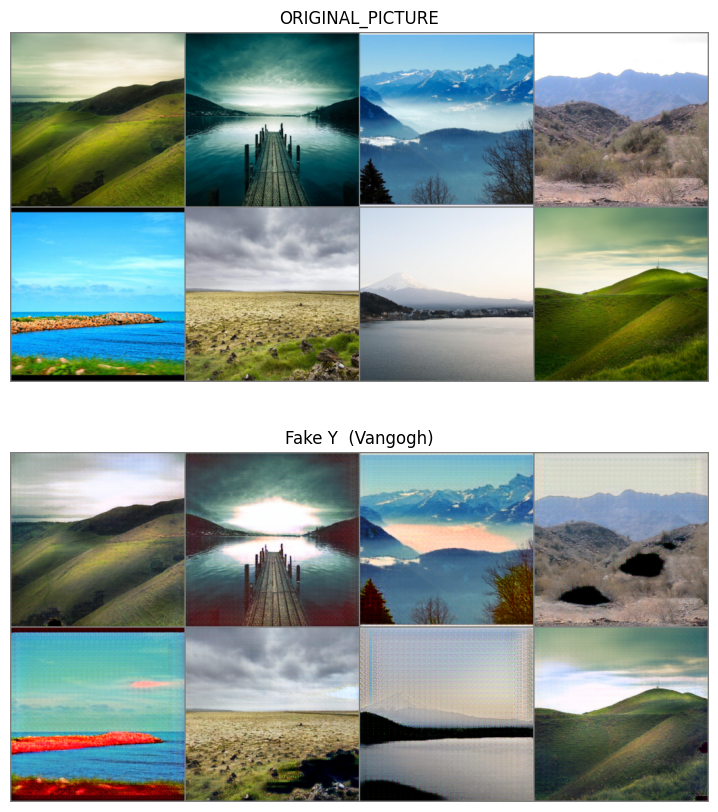

Epoch [  81/ 300] || DiscriminativeTotalLossAvg: 0.060 || GenerativeTotalLossAvg: 5.027
Epoch [  82/ 300] || DiscriminativeTotalLossAvg: 0.191 || GenerativeTotalLossAvg: 4.917
Epoch [  83/ 300] || DiscriminativeTotalLossAvg: 0.071 || GenerativeTotalLossAvg: 4.954
Epoch [  84/ 300] || DiscriminativeTotalLossAvg: 0.068 || GenerativeTotalLossAvg: 4.950
Epoch [  85/ 300] || DiscriminativeTotalLossAvg: 0.063 || GenerativeTotalLossAvg: 4.957
Epoch [  86/ 300] || DiscriminativeTotalLossAvg: 0.063 || GenerativeTotalLossAvg: 4.985
Epoch [  87/ 300] || DiscriminativeTotalLossAvg: 0.058 || GenerativeTotalLossAvg: 4.971
Epoch [  88/ 300] || DiscriminativeTotalLossAvg: 0.054 || GenerativeTotalLossAvg: 4.965
Epoch [  89/ 300] || DiscriminativeTotalLossAvg: 0.058 || GenerativeTotalLossAvg: 4.958
Epoch [  90/ 300] || DiscriminativeTotalLossAvg: 0.059 || GenerativeTotalLossAvg: 4.963


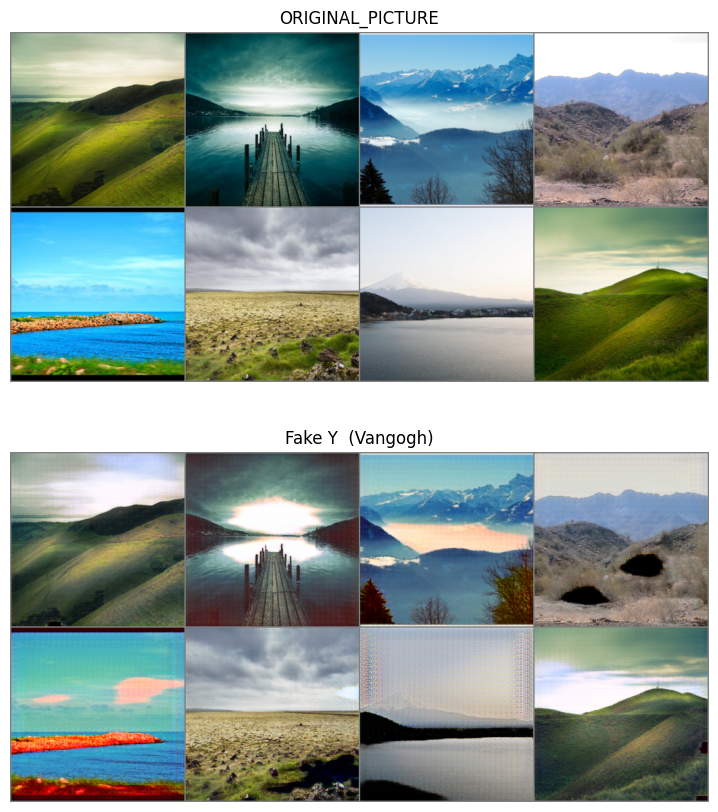

Epoch [  91/ 300] || DiscriminativeTotalLossAvg: 0.057 || GenerativeTotalLossAvg: 4.978
Epoch [  92/ 300] || DiscriminativeTotalLossAvg: 0.057 || GenerativeTotalLossAvg: 4.950
Epoch [  93/ 300] || DiscriminativeTotalLossAvg: 0.053 || GenerativeTotalLossAvg: 4.959
Epoch [  94/ 300] || DiscriminativeTotalLossAvg: 0.055 || GenerativeTotalLossAvg: 4.969
Epoch [  95/ 300] || DiscriminativeTotalLossAvg: 0.052 || GenerativeTotalLossAvg: 4.963
Epoch [  96/ 300] || DiscriminativeTotalLossAvg: 0.056 || GenerativeTotalLossAvg: 4.938
Epoch [  97/ 300] || DiscriminativeTotalLossAvg: 0.058 || GenerativeTotalLossAvg: 4.933
Epoch [  98/ 300] || DiscriminativeTotalLossAvg: 0.056 || GenerativeTotalLossAvg: 4.949
Epoch [  99/ 300] || DiscriminativeTotalLossAvg: 0.062 || GenerativeTotalLossAvg: 4.912
Epoch [ 100/ 300] || DiscriminativeTotalLossAvg: 0.050 || GenerativeTotalLossAvg: 4.959


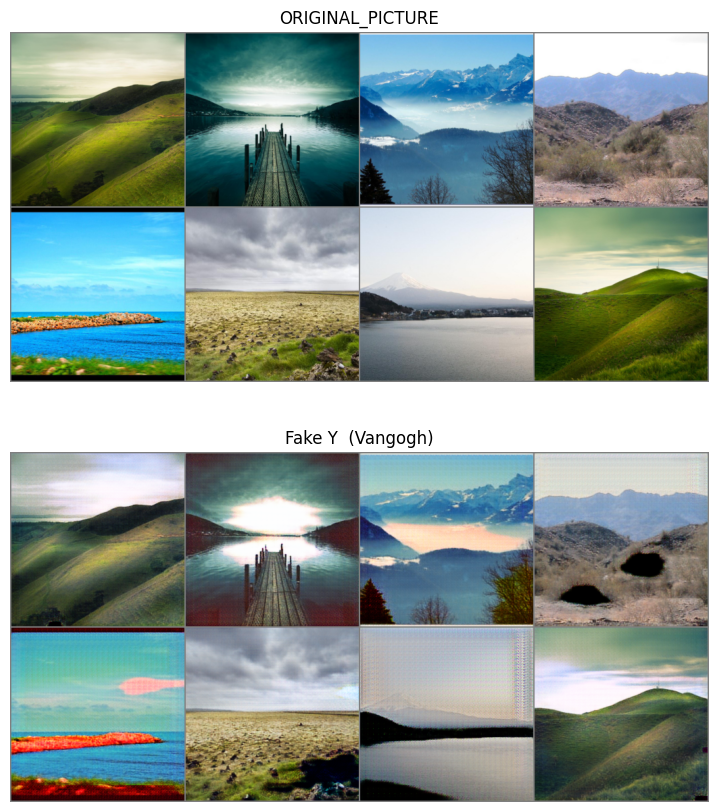

Epoch [ 101/ 300] || DiscriminativeTotalLossAvg: 0.058 || GenerativeTotalLossAvg: 4.942
Epoch [ 102/ 300] || DiscriminativeTotalLossAvg: 0.050 || GenerativeTotalLossAvg: 4.927
Epoch [ 103/ 300] || DiscriminativeTotalLossAvg: 0.053 || GenerativeTotalLossAvg: 4.929
Epoch [ 104/ 300] || DiscriminativeTotalLossAvg: 0.055 || GenerativeTotalLossAvg: 4.926
Epoch [ 105/ 300] || DiscriminativeTotalLossAvg: 0.053 || GenerativeTotalLossAvg: 4.909
Epoch [ 106/ 300] || DiscriminativeTotalLossAvg: 0.051 || GenerativeTotalLossAvg: 4.930
Epoch [ 107/ 300] || DiscriminativeTotalLossAvg: 0.058 || GenerativeTotalLossAvg: 4.916
Epoch [ 108/ 300] || DiscriminativeTotalLossAvg: 0.048 || GenerativeTotalLossAvg: 4.895
Epoch [ 109/ 300] || DiscriminativeTotalLossAvg: 0.056 || GenerativeTotalLossAvg: 4.888
Epoch [ 110/ 300] || DiscriminativeTotalLossAvg: 0.050 || GenerativeTotalLossAvg: 4.894


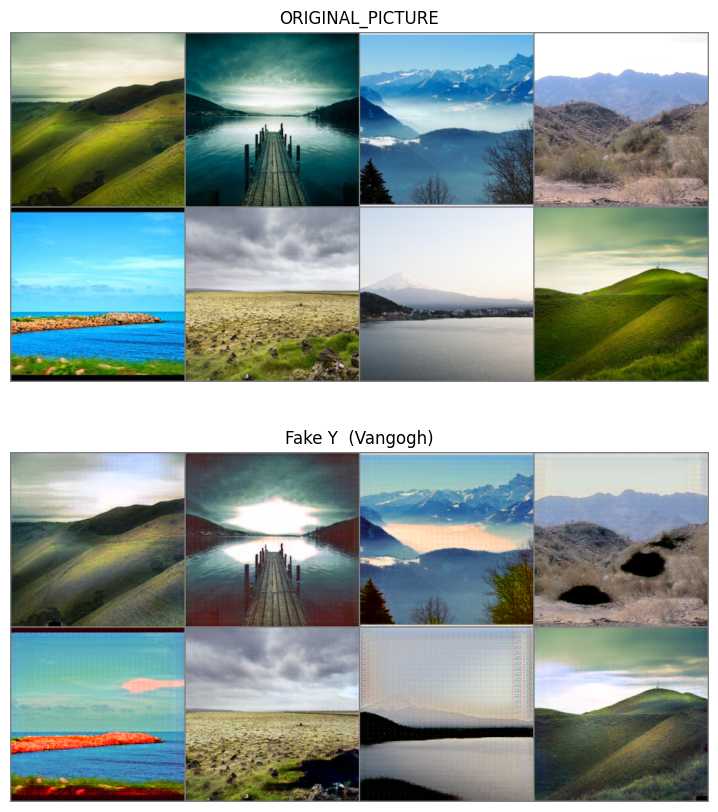

Epoch [ 111/ 300] || DiscriminativeTotalLossAvg: 0.045 || GenerativeTotalLossAvg: 4.910
Epoch [ 112/ 300] || DiscriminativeTotalLossAvg: 0.055 || GenerativeTotalLossAvg: 4.901
Epoch [ 113/ 300] || DiscriminativeTotalLossAvg: 0.058 || GenerativeTotalLossAvg: 4.875
Epoch [ 114/ 300] || DiscriminativeTotalLossAvg: 0.043 || GenerativeTotalLossAvg: 4.910
Epoch [ 115/ 300] || DiscriminativeTotalLossAvg: 0.050 || GenerativeTotalLossAvg: 4.904
Epoch [ 116/ 300] || DiscriminativeTotalLossAvg: 0.093 || GenerativeTotalLossAvg: 4.843
Epoch [ 117/ 300] || DiscriminativeTotalLossAvg: 0.045 || GenerativeTotalLossAvg: 4.840
Epoch [ 118/ 300] || DiscriminativeTotalLossAvg: 0.051 || GenerativeTotalLossAvg: 4.860
Epoch [ 119/ 300] || DiscriminativeTotalLossAvg: 0.047 || GenerativeTotalLossAvg: 4.889
Epoch [ 120/ 300] || DiscriminativeTotalLossAvg: 0.047 || GenerativeTotalLossAvg: 4.865


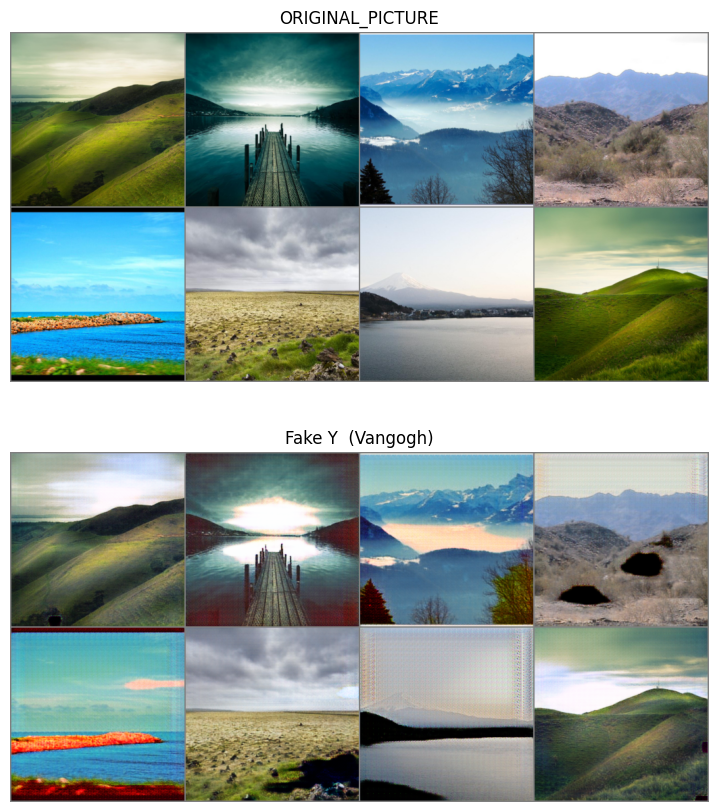

Epoch [ 121/ 300] || DiscriminativeTotalLossAvg: 0.045 || GenerativeTotalLossAvg: 4.892
Epoch [ 122/ 300] || DiscriminativeTotalLossAvg: 0.158 || GenerativeTotalLossAvg: 4.829
Epoch [ 123/ 300] || DiscriminativeTotalLossAvg: 0.059 || GenerativeTotalLossAvg: 4.839
Epoch [ 124/ 300] || DiscriminativeTotalLossAvg: 0.047 || GenerativeTotalLossAvg: 4.853
Epoch [ 125/ 300] || DiscriminativeTotalLossAvg: 0.046 || GenerativeTotalLossAvg: 4.852
Epoch [ 126/ 300] || DiscriminativeTotalLossAvg: 0.050 || GenerativeTotalLossAvg: 4.839
Epoch [ 127/ 300] || DiscriminativeTotalLossAvg: 0.045 || GenerativeTotalLossAvg: 4.866
Epoch [ 128/ 300] || DiscriminativeTotalLossAvg: 0.047 || GenerativeTotalLossAvg: 4.869
Epoch [ 129/ 300] || DiscriminativeTotalLossAvg: 0.051 || GenerativeTotalLossAvg: 4.857
Epoch [ 130/ 300] || DiscriminativeTotalLossAvg: 0.047 || GenerativeTotalLossAvg: 4.878


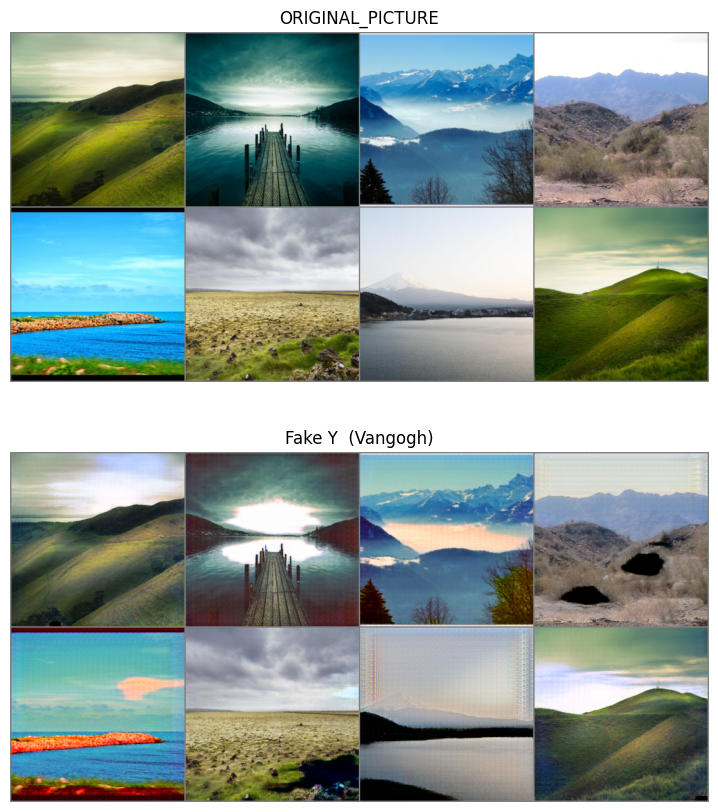

Epoch [ 131/ 300] || DiscriminativeTotalLossAvg: 0.129 || GenerativeTotalLossAvg: 4.851
Epoch [ 132/ 300] || DiscriminativeTotalLossAvg: 0.055 || GenerativeTotalLossAvg: 4.825
Epoch [ 133/ 300] || DiscriminativeTotalLossAvg: 0.048 || GenerativeTotalLossAvg: 4.851
Epoch [ 134/ 300] || DiscriminativeTotalLossAvg: 0.044 || GenerativeTotalLossAvg: 4.851
Epoch [ 135/ 300] || DiscriminativeTotalLossAvg: 0.050 || GenerativeTotalLossAvg: 4.852
Epoch [ 136/ 300] || DiscriminativeTotalLossAvg: 0.059 || GenerativeTotalLossAvg: 4.849
Epoch [ 137/ 300] || DiscriminativeTotalLossAvg: 0.044 || GenerativeTotalLossAvg: 4.813
Epoch [ 138/ 300] || DiscriminativeTotalLossAvg: 0.041 || GenerativeTotalLossAvg: 4.836
Epoch [ 139/ 300] || DiscriminativeTotalLossAvg: 0.046 || GenerativeTotalLossAvg: 4.853
Epoch [ 140/ 300] || DiscriminativeTotalLossAvg: 0.050 || GenerativeTotalLossAvg: 4.815


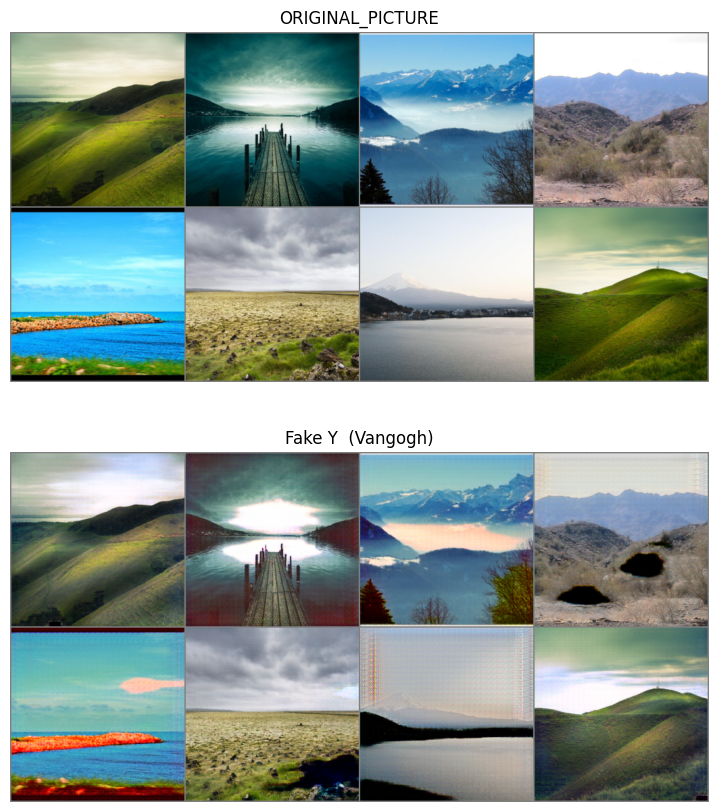

Epoch [ 141/ 300] || DiscriminativeTotalLossAvg: 0.044 || GenerativeTotalLossAvg: 4.831
Epoch [ 142/ 300] || DiscriminativeTotalLossAvg: 0.045 || GenerativeTotalLossAvg: 4.841
Epoch [ 143/ 300] || DiscriminativeTotalLossAvg: 0.048 || GenerativeTotalLossAvg: 4.841
Epoch [ 144/ 300] || DiscriminativeTotalLossAvg: 0.052 || GenerativeTotalLossAvg: 4.846
Epoch [ 145/ 300] || DiscriminativeTotalLossAvg: 0.042 || GenerativeTotalLossAvg: 4.818
Epoch [ 146/ 300] || DiscriminativeTotalLossAvg: 0.045 || GenerativeTotalLossAvg: 4.825
Epoch [ 147/ 300] || DiscriminativeTotalLossAvg: 0.047 || GenerativeTotalLossAvg: 4.833
Epoch [ 148/ 300] || DiscriminativeTotalLossAvg: 0.044 || GenerativeTotalLossAvg: 4.846
Epoch [ 149/ 300] || DiscriminativeTotalLossAvg: 0.045 || GenerativeTotalLossAvg: 4.811
Epoch [ 150/ 300] || DiscriminativeTotalLossAvg: 0.051 || GenerativeTotalLossAvg: 4.820


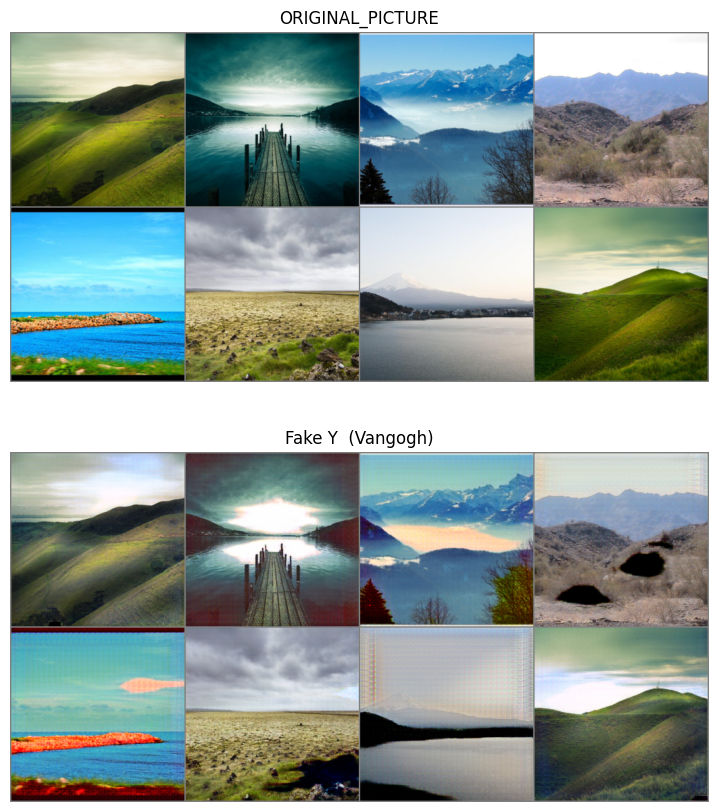

Epoch [ 151/ 300] || DiscriminativeTotalLossAvg: 0.043 || GenerativeTotalLossAvg: 4.786
Epoch [ 152/ 300] || DiscriminativeTotalLossAvg: 0.045 || GenerativeTotalLossAvg: 4.826
Epoch [ 153/ 300] || DiscriminativeTotalLossAvg: 0.044 || GenerativeTotalLossAvg: 4.810
Epoch [ 154/ 300] || DiscriminativeTotalLossAvg: 0.046 || GenerativeTotalLossAvg: 4.827
Epoch [ 155/ 300] || DiscriminativeTotalLossAvg: 0.042 || GenerativeTotalLossAvg: 4.799
Epoch [ 156/ 300] || DiscriminativeTotalLossAvg: 0.045 || GenerativeTotalLossAvg: 4.807
Epoch [ 157/ 300] || DiscriminativeTotalLossAvg: 0.048 || GenerativeTotalLossAvg: 4.809
Epoch [ 158/ 300] || DiscriminativeTotalLossAvg: 0.040 || GenerativeTotalLossAvg: 4.805
Epoch [ 159/ 300] || DiscriminativeTotalLossAvg: 0.046 || GenerativeTotalLossAvg: 4.823
Epoch [ 160/ 300] || DiscriminativeTotalLossAvg: 0.041 || GenerativeTotalLossAvg: 4.835


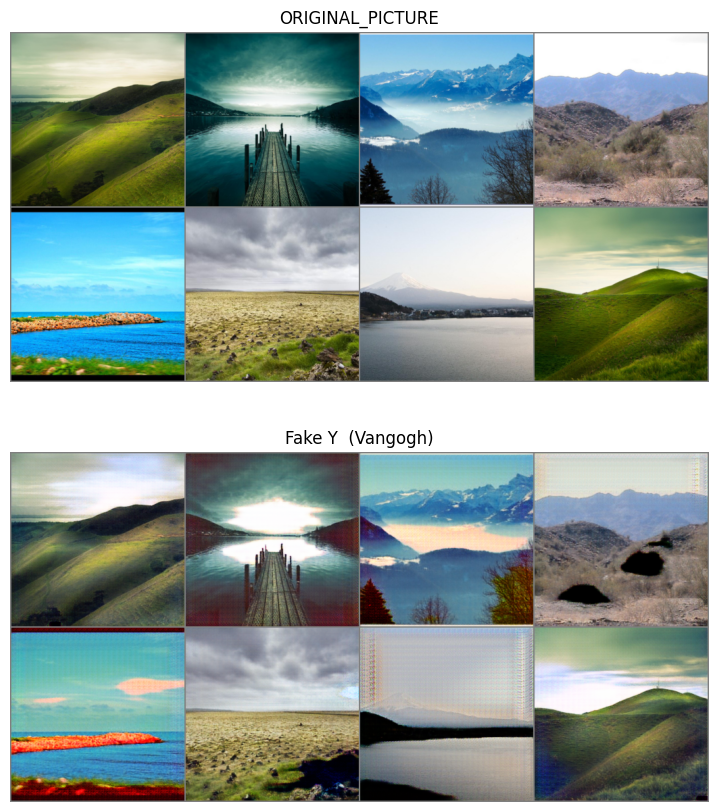

Epoch [ 161/ 300] || DiscriminativeTotalLossAvg: 0.044 || GenerativeTotalLossAvg: 4.787
Epoch [ 162/ 300] || DiscriminativeTotalLossAvg: 0.052 || GenerativeTotalLossAvg: 4.763
Epoch [ 163/ 300] || DiscriminativeTotalLossAvg: 0.043 || GenerativeTotalLossAvg: 4.782
Epoch [ 164/ 300] || DiscriminativeTotalLossAvg: 0.044 || GenerativeTotalLossAvg: 4.805
Epoch [ 165/ 300] || DiscriminativeTotalLossAvg: 0.041 || GenerativeTotalLossAvg: 4.806
Epoch [ 166/ 300] || DiscriminativeTotalLossAvg: 0.037 || GenerativeTotalLossAvg: 4.794
Epoch [ 167/ 300] || DiscriminativeTotalLossAvg: 0.038 || GenerativeTotalLossAvg: 4.809
Epoch [ 168/ 300] || DiscriminativeTotalLossAvg: 0.044 || GenerativeTotalLossAvg: 4.817
Epoch [ 169/ 300] || DiscriminativeTotalLossAvg: 0.045 || GenerativeTotalLossAvg: 4.763
Epoch [ 170/ 300] || DiscriminativeTotalLossAvg: 0.048 || GenerativeTotalLossAvg: 4.799


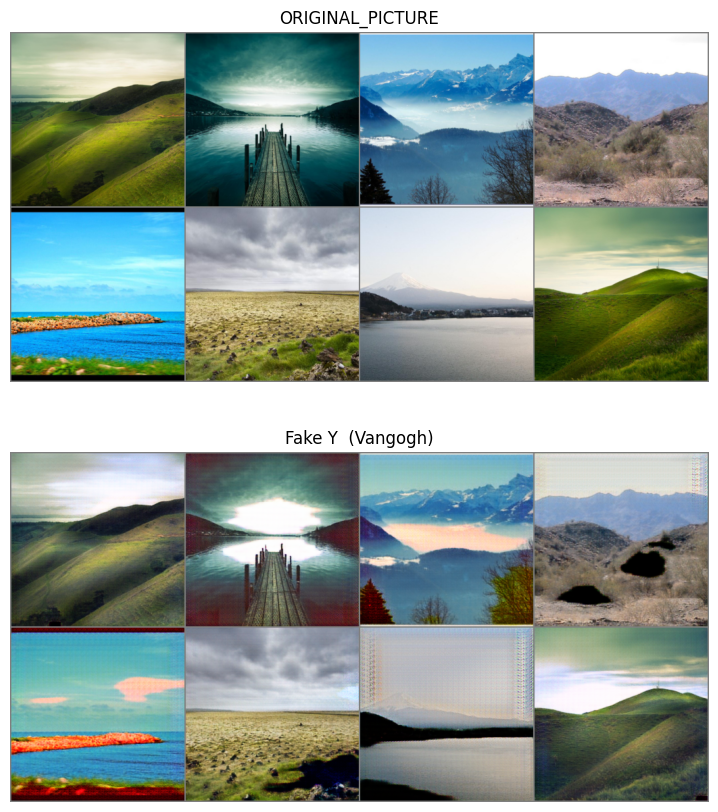

Epoch [ 171/ 300] || DiscriminativeTotalLossAvg: 0.044 || GenerativeTotalLossAvg: 4.777
Epoch [ 172/ 300] || DiscriminativeTotalLossAvg: 0.039 || GenerativeTotalLossAvg: 4.785
Epoch [ 173/ 300] || DiscriminativeTotalLossAvg: 0.044 || GenerativeTotalLossAvg: 4.749
Epoch [ 174/ 300] || DiscriminativeTotalLossAvg: 0.045 || GenerativeTotalLossAvg: 4.790
Epoch [ 175/ 300] || DiscriminativeTotalLossAvg: 0.040 || GenerativeTotalLossAvg: 4.756
Epoch [ 176/ 300] || DiscriminativeTotalLossAvg: 0.061 || GenerativeTotalLossAvg: 4.767
Epoch [ 177/ 300] || DiscriminativeTotalLossAvg: 0.040 || GenerativeTotalLossAvg: 4.806
Epoch [ 178/ 300] || DiscriminativeTotalLossAvg: 0.037 || GenerativeTotalLossAvg: 4.787
Epoch [ 179/ 300] || DiscriminativeTotalLossAvg: 0.038 || GenerativeTotalLossAvg: 4.766
Epoch [ 180/ 300] || DiscriminativeTotalLossAvg: 0.041 || GenerativeTotalLossAvg: 4.765


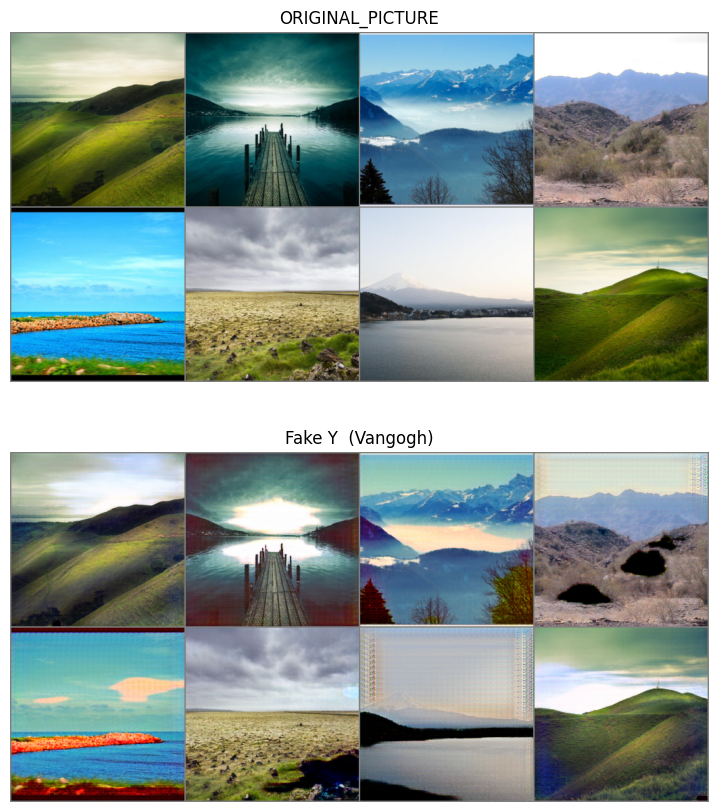

Epoch [ 181/ 300] || DiscriminativeTotalLossAvg: 0.039 || GenerativeTotalLossAvg: 4.770
Epoch [ 182/ 300] || DiscriminativeTotalLossAvg: 0.037 || GenerativeTotalLossAvg: 4.785
Epoch [ 183/ 300] || DiscriminativeTotalLossAvg: 0.036 || GenerativeTotalLossAvg: 4.749
Epoch [ 184/ 300] || DiscriminativeTotalLossAvg: 0.041 || GenerativeTotalLossAvg: 4.789
Epoch [ 185/ 300] || DiscriminativeTotalLossAvg: 0.038 || GenerativeTotalLossAvg: 4.774
Epoch [ 186/ 300] || DiscriminativeTotalLossAvg: 0.064 || GenerativeTotalLossAvg: 4.733
Epoch [ 187/ 300] || DiscriminativeTotalLossAvg: 0.033 || GenerativeTotalLossAvg: 4.788


In [ ]:
batchesPerEpoch = min(len(dataloaderY),len(dataloaderX))
NumberEpoch = 300
import torch
torch.cuda.empty_cache()
numberOfEpochs = NumberEpoch * batchesPerEpoch
losses = trainModel(dataloaderX, dataloaderY, DataloaderXForTest, DataloaderYForTest, NumOfEpoch=numberOfEpochs)



However Limited available RAM and Time on Colab , I was able to run my code until 187 iteration . Still I have good result althought I run code halfly.
Discriminatives model Total Loss got enough small by training our programme . Also Generative Loss decreased from around 8.000 to 4.788 , so running programme by all iteration it will decrease less then 2.000 so it will show much more Van Gogh style on Nature pictures.Until now running time is 22 hours , probably running all until 300 epocs was going to 40 hours altought I used batch and instance normalization and dropout technics to decrease model running time and loss.  

In [ ]:
#Plot loss functions over training
figure, ax = plt.subplots(figsize=(12,8))
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminators', alpha=0.5)
plt.plot(losses.T[1], label='Generators', alpha=0.5)
plt.title("Training Losses")
plt.legend()
plt.show()

Get some fixed data from domains X and Y for sampling. These areimages that are held constant throughout training, that allowus to inspect the model's performance.

In [ ]:

IterationXtest = iter(DataloaderXForTest)
IterationYtest = iter(DataloaderYForTest)

See our Model performance on another batch of pictures . This model can be applied any image of natures.

In [ ]:
#Sample
Xfix = IterationXtest.next()
Xfix = IterationXtest.next()
Xfix = IterationXtest.next()

#Evaluation
Generative_XtoY_Model.eval()

meanValue=0.5
stdValue=0.5

#Identify correct device
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

#Create fake pictures for both cycles
YFake = Generative_XtoY_Model(Xfix.to(device))

#Generate grids
Xgrid =  make_grid(Xfix, nrow=4).permute(1, 2, 0).detach().cpu().numpy()
YFakeGrid =  make_grid(YFake, nrow=4).permute(1, 2, 0).detach().cpu().numpy()

#Normalize pictures to pixel range rom 0 to 255
OrginalPic, YFake = reNormalize(Xgrid, meanValue, stdValue), reNormalize(YFakeGrid, meanValue, stdValue)

#Transformation from X -> Y
figure, (ax, ax1) = plt.subplots(2, 1, sharex=True, sharey=True, squeeze=True, width_ratios=None, height_ratios=None, figsize=(30, 20))
ax.imshow(OrginalPic)
ax.axis('off')
ax.set_title('Original Picture')
ax1.imshow(YFake)
ax1.axis('off')
ax1.set_title('Fake Picture, Van Gogh Style')
plt.show()

Make a video from what is produced by each 10 during 0 to 300 iteration.

In [ ]:
import cv2
import numpy as np
import glob

frameSize = (500, 500)

out = cv2.VideoWriter('output_video.mp4',cv2.VideoWriter_fourcc(*'DIVX'), 60, frameSize)

for filename in glob.glob('generated'):
    img = cv2.imread(filename)
    out.write(img)

out.release()